## P5.3 Image generation for gif

### Introduction 
1. Separate notebook for animation of global world terrorism incidents through the years 1970 - 2017. Inspired by the work of Hans Rosling.
2. From the earlier EDAs of global terrorism, we covered spatial and very briefly temporal aspects (by decades). In this notebook, we aim to combine these aspects to visualise total number of incidents per year based on reported geo coordinates.
---

### Content
- [BaseMap Animate Prep](#BaseMap-Animate-Prep)
- [Create Images](#Create-Images)
- [Create gif](#Create-gif)


### BaseMap Animate Prep

In [1]:
# Import libraries
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.basemap import Basemap
plt.style.use('seaborn-darkgrid')

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
# Setting - display all columns
pd.set_option('display.max_columns', None)

In [3]:
df = pd.read_csv('../assets/terrorclean.csv',encoding="ISO-8859-1",index_col=0)

In [4]:
df.head(2)

,eventid,iyear,imonth,iday,country,region,lat,lon,crit1,crit2,crit3,success,suicide,atkmode,targtype,targnat,gname,motive,indiv,weaptype,nkill,nwound,property
0,197000000001,1970,7,2,Dominican Republic,Central America & Caribbean,18.456792,-69.951164,1,1,1,1,0,assassination,citizens and property,dominican republic,mano-d,unknown,0,unknown,1,0,0
1,197000000002,1970,0,0,Mexico,North America,19.371887,-99.086624,1,1,1,1,0,hostage kidnap,diplomats,belgium,23rd of september communist league,unknown,0,unknown,0,0,0


In [5]:
df_yr=df.copy()
df_yr = df_yr.groupby(['iyear','region','lon','lat']).size().to_frame(name = 'inci_count').reset_index()
# Top 10 years with cumulative highest incidents
print(df_yr.iyear.value_counts()[:10])
# Max incidents of the year
df_yr.inci_count.max()

2014    6151
2015    5783
2016    5519
2017    5034
2013    4287
2012    2696
2009    1732
2008    1724
2010    1685
2011    1601
Name: iyear, dtype: int64


966

In [6]:
# Sanity check of year 
df_yr.iyear.unique()

array([1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980,
       1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991,
       1992, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003,
       2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014,
       2015, 2016, 2017], dtype=int64)

### Create Images

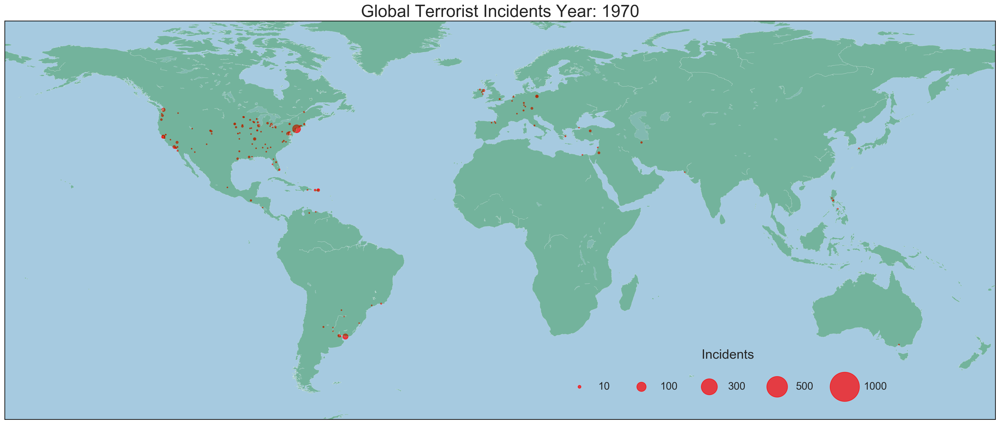

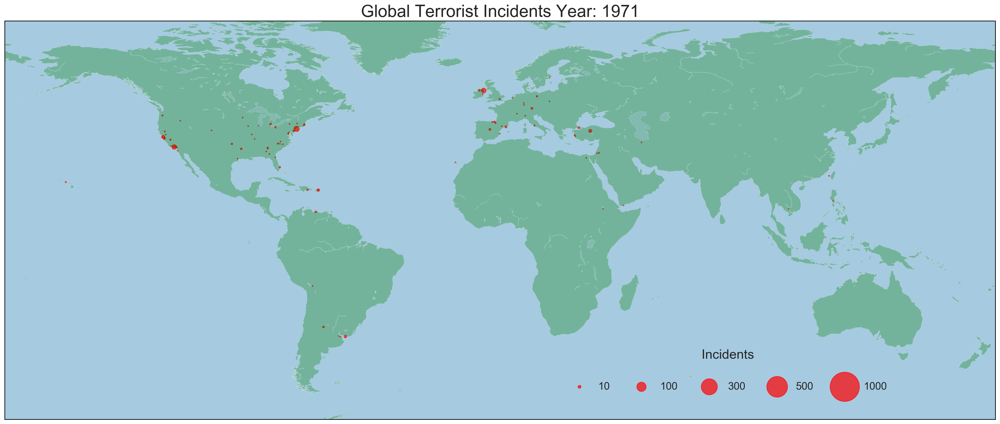

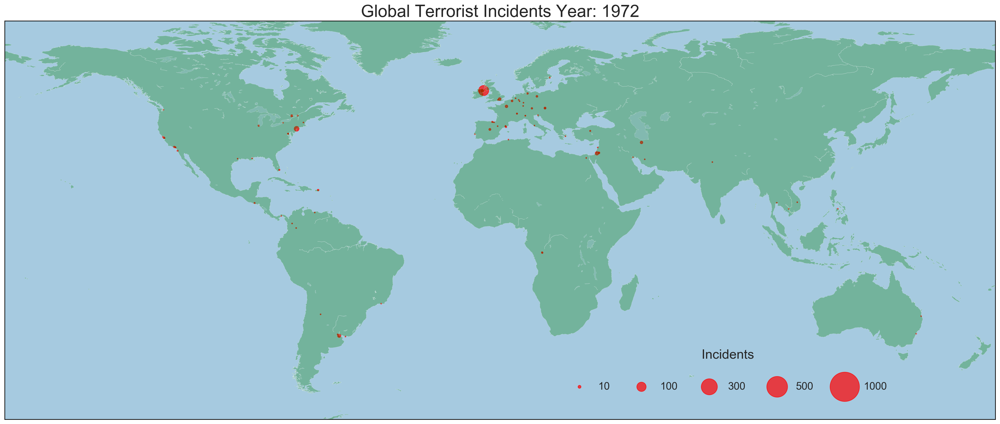

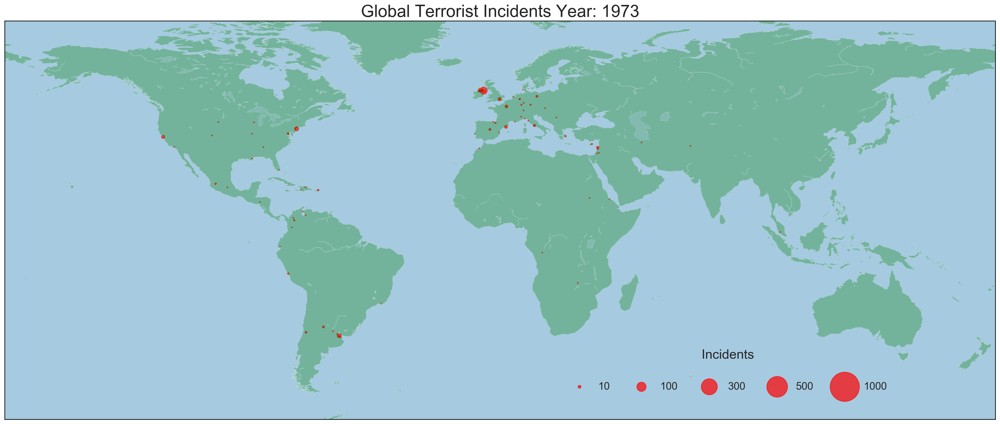

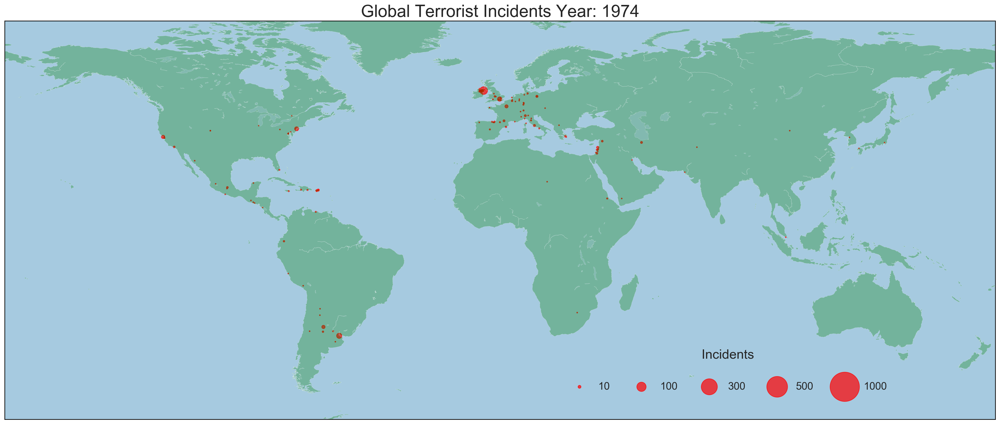

...

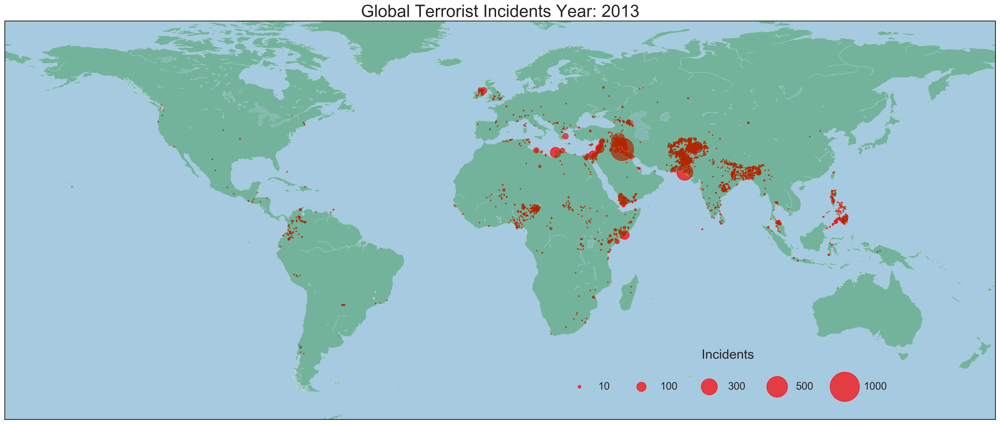

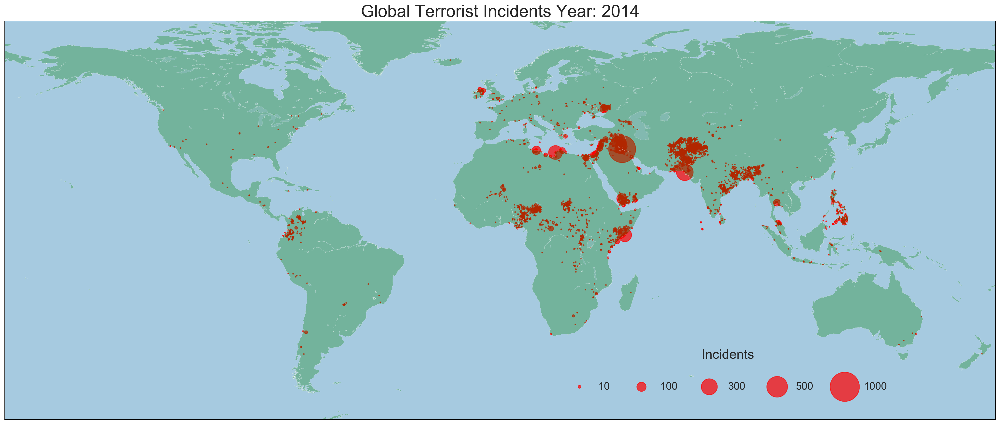

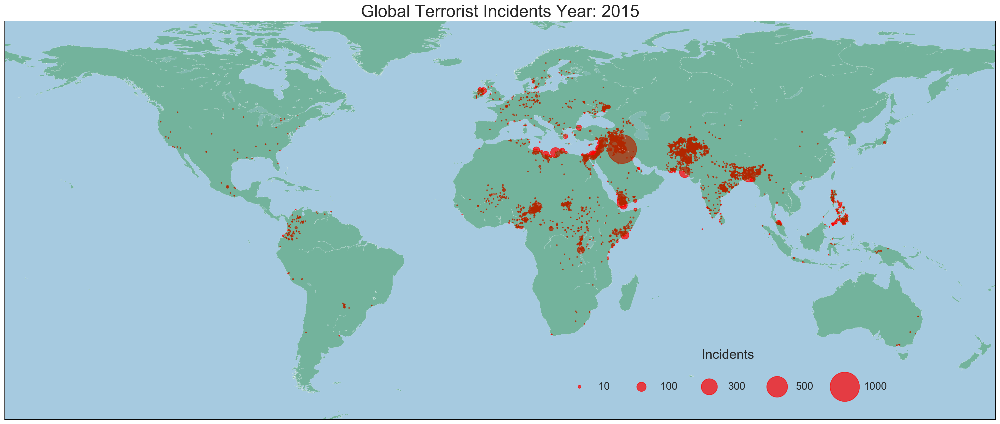

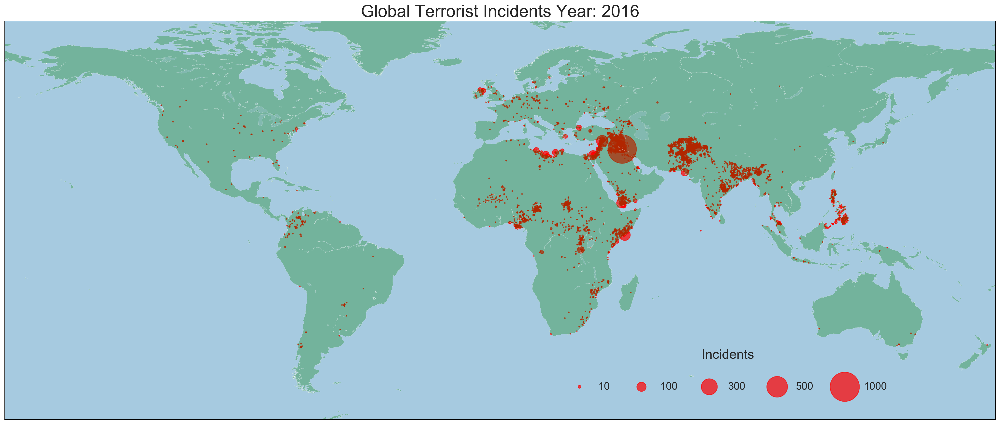

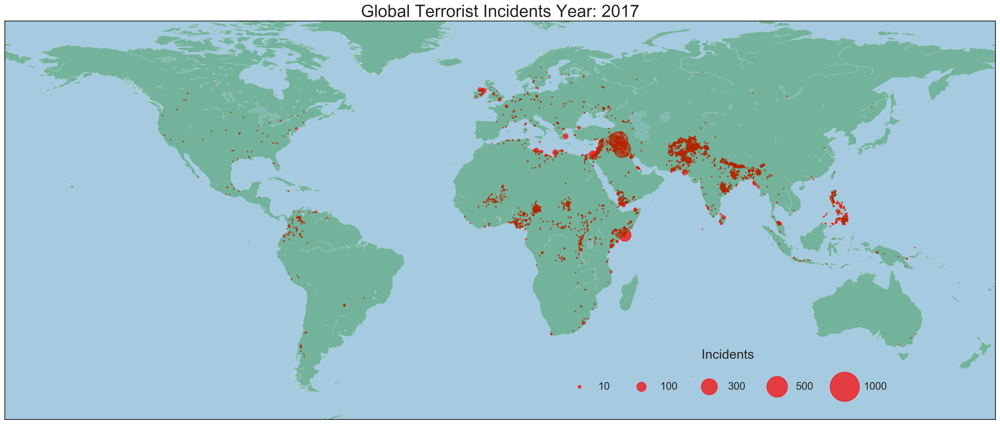

In [7]:
my_dpi=96

# For each year
for i in df_yr.iyear.unique():
    # Initialize figure
    plt.figure(figsize=(2600/my_dpi, 1800/my_dpi), dpi=my_dpi)
    # Make the background map
    m=Basemap(projection='cyl',llcrnrlon=-180, llcrnrlat=-65,urcrnrlon=180,urcrnrlat=80,resolution='l')
    m.drawmapboundary(fill_color='#A6CAE0', linewidth=1)
    m.fillcontinents(color='green', alpha=0.3)
    m.drawcoastlines(linewidth=0.1, color="white")
    
    # Function to extract relative year data
    tmp = df_yr[df_yr['iyear'] == i]
    # Add a point per position
    m.scatter(tmp['lon'], tmp['lat'],s=tmp.inci_count*2, alpha=0.7, c='r')
    # Title
    plt.title("Global Terrorist Incidents Year: " + str(i), fontsize=26)
    # Legend
    for a in [10,100,300,500,1000]:
        plt.scatter([], [], c='r', alpha=0.7, s=a*2, label=str(a))
    plt.legend(scatterpoints=1, frameon=False, labelspacing=2, loc='upper right',bbox_to_anchor=(0.9,0.2,0,0),\
           title ='Incidents',ncol=5, title_fontsize=20, fontsize=16);
    # Save generated images
    filename='../misc/Gapminder_step'+str(i)+'.png'
    plt.savefig(filename, dpi=96)
    plt.gca()

### Create gif

For purpose of presentation, data from years 2000-2017 only is selected for gif creation. Create the gif via either of the steps:
- powerpoint export as gif (glitchy imaging)
- gif create at https://gifmaker.me/ (utilized this method)
- imagemagick convert (shell command) (note: somehow, this breaks on machine. The generated gif file self-deletes after some time.)

---